https://www.kaggle.com/arjunbhasin2013/ccdata

# 1. Import libraries

In [1]:
import os
os.chdir("C:\\Users\\KonuTech\\Downloads\\kickstarter-Credit-Card-Dataset-for-Clustering")

In [2]:
from functions import *

# 2. Import and read data

In [3]:
get_list_of_zip_files(directory="C:\\Users\\KonuTech\\Downloads\\")[0:2]

['airbnb-recruiting-new-user-bookings.zip', 'archive (1).zip']

In [4]:
unzip_files(directory="C:\\Users\\KonuTech\\Downloads"
            ,output_directory="C:\\Users\\KonuTech\\Downloads\\kickstarter-Credit-Card-Dataset-for-Clustering"
            ,zip_file_name="archive (1).zip")

Unpacked archive (1).zip to: C:\Users\KonuTech\Downloads\kickstarter-Credit-Card-Dataset-for-Clustering



In [5]:
change_current_working_directory(directory="C:\\Users\\KonuTech\\Downloads\\kickstarter-Credit-Card-Dataset-for-Clustering")

'C:\\Users\\KonuTech\\Downloads\\kickstarter-Credit-Card-Dataset-for-Clustering'

In [6]:
get_list_of_files_by_extension(directory="C:\\Users\\KonuTech\\Downloads\\kickstarter-Credit-Card-Dataset-for-Clustering"
                               ,extension="csv")

['CC GENERAL.csv']

# 3. Data description

### Train data

In [7]:
credit_cards = pd.read_csv('CC GENERAL.csv',index_col=["CUST_ID"])
credit_cards.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
CUST_ID,,,,,,,,,,,,,,,,,
C10001,40.901,0.818,95.400,0.000,95.400,0.000,0.167,0.000,0.083,0.000,0,2,1000.000,201.802,139.510,0.000,12
C10002,3202.467,0.909,0.000,0.000,0.000,6442.945,0.000,0.000,0.000,0.250,4,0,7000.000,4103.033,1072.340,0.222,12
C10003,2495.149,1.000,773.170,773.170,0.000,0.000,1.000,1.000,0.000,0.000,0,12,7500.000,622.067,627.285,0.000,12
C10004,1666.671,0.636,1499.000,1499.000,0.000,205.788,0.083,0.083,0.000,0.083,1,1,7500.000,0.000,nan,0.000,12
C10005,817.714,1.000,16.000,16.000,0.000,0.000,0.083,0.083,0.000,0.000,0,1,1200.000,678.335,244.791,0.000,12


In [8]:
credit_cards.select_dtypes(include=['int64', "uint8"])

,CASH_ADVANCE_TRX,PURCHASES_TRX,TENURE
CUST_ID,,,
C10001,0,2,12
C10002,4,0,12
C10003,0,12,12
C10004,1,1,12
C10005,0,1,12
...,...,...,...
C19186,0,6,6
C19187,0,6,6
C19188,0,5,6


In [9]:
credit_cards[credit_cards.select_dtypes(include=['int64', "uint8"]).columns] = credit_cards[credit_cards.select_dtypes(include=['int64', "uint8"]).columns].astype(float)

In [10]:
credit_cards.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8950 entries, C10001 to C19190
Data columns (total 17 columns):
BALANCE                             8950 non-null float64
BALANCE_FREQUENCY                   8950 non-null float64
PURCHASES                           8950 non-null float64
ONEOFF_PURCHASES                    8950 non-null float64
INSTALLMENTS_PURCHASES              8950 non-null float64
CASH_ADVANCE                        8950 non-null float64
PURCHASES_FREQUENCY                 8950 non-null float64
ONEOFF_PURCHASES_FREQUENCY          8950 non-null float64
PURCHASES_INSTALLMENTS_FREQUENCY    8950 non-null float64
CASH_ADVANCE_FREQUENCY              8950 non-null float64
CASH_ADVANCE_TRX                    8950 non-null float64
PURCHASES_TRX                       8950 non-null float64
CREDIT_LIMIT                        8949 non-null float64
PAYMENTS                            8950 non-null float64
MINIMUM_PAYMENTS                    8637 non-null float64
PRC_FULL_PAYMENT     

In [11]:
credit_cards.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8950.000,8949.000,8950.000,8637.000,8950.000,8950.000
mean,1564.475,0.877,1003.205,592.437,411.068,978.871,0.490,0.202,0.364,0.135,3.249,14.710,4494.449,1733.144,864.207,0.154,11.517
std,2081.532,0.237,2136.635,1659.888,904.338,2097.164,0.401,0.298,0.397,0.200,6.825,24.858,3638.816,2895.064,2372.447,0.292,1.338
min,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,50.000,0.000,0.019,0.000,6.000
25%,128.282,0.889,39.635,0.000,0.000,0.000,0.083,0.000,0.000,0.000,0.000,1.000,1600.000,383.276,169.124,0.000,12.000
50%,873.385,1.000,361.280,38.000,89.000,0.000,0.500,0.083,0.167,0.000,0.000,7.000,3000.000,856.902,312.344,0.000,12.000
75%,2054.140,1.000,1110.130,577.405,468.637,1113.821,0.917,0.300,0.750,0.222,4.000,17.000,6500.000,1901.134,825.485,0.143,12.000
max,19043.139,1.000,49039.570,40761.250,22500.000,47137.212,1.000,1.000,1.000,1.500,123.000,358.000,30000.000,50721.483,76406.208,1.000,12.000


# 4. Exploratory Data Analysis

### Number of columns with Null values

In [12]:
(credit_cards.isnull().sum() > 0).sum()

2

In [13]:
missing_data_count = pd.DataFrame(credit_cards.isnull().sum().sort_values(ascending=False))
missing_data_count.T

,MINIMUM_PAYMENTS,CREDIT_LIMIT,TENURE,PURCHASES_FREQUENCY,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_INSTALLMENTS_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PRC_FULL_PAYMENT,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,PAYMENTS,BALANCE
0,313,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Rate of missing values of columns

In [14]:
rate_of_missing_data = pd.DataFrame(((credit_cards.isnull().sum().sort_values(ascending=False))/credit_cards.shape[0]))
rate_of_missing_data.T

,MINIMUM_PAYMENTS,CREDIT_LIMIT,TENURE,PURCHASES_FREQUENCY,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_INSTALLMENTS_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PRC_FULL_PAYMENT,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,PAYMENTS,BALANCE
0,0.035,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000


### Null values of "MINIMUM_PAYMENTS" column

In [15]:
credit_cards[credit_cards["MINIMUM_PAYMENTS"].isnull()].head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
CUST_ID,,,,,,,,,,,,,,,,,
C10004,1666.671,0.636,1499.000,1499.000,0.000,205.788,0.083,0.083,0.000,0.083,1.000,1.000,7500.000,0.000,nan,0.000,12.000
C10047,2242.312,1.000,437.000,97.000,340.000,184.649,0.333,0.083,0.333,0.167,2.000,5.000,2400.000,0.000,nan,0.000,12.000
C10049,3910.111,1.000,0.000,0.000,0.000,1980.873,0.000,0.000,0.000,0.500,7.000,0.000,4200.000,0.000,nan,0.000,12.000
C10056,6.661,0.636,310.000,0.000,310.000,0.000,0.667,0.000,0.667,0.000,0.000,8.000,1000.000,417.017,nan,0.000,12.000
C10057,1311.996,1.000,1283.900,1283.900,0.000,0.000,0.250,0.250,0.000,0.000,0.000,6.000,6000.000,0.000,nan,0.000,12.000


### Counts of unique values including Null values

In [16]:
count_unique_values(dataframe=credit_cards
                    ,variables=credit_cards.columns)

BALANCE count distinct:
0.0                   80
1100.941072            1
40.074484000000005     1
2093.8446559999998     1
179.76570800000002     1
                      ..
3494.152843            1
2388.503738            1
2153.498372            1
510.233775             1
nan                    0
Length: 8872, dtype: int64

BALANCE_FREQUENCY count distinct:
1.0                    6211
0.909091                410
0.818182                278
0.727273                223
0.545455                219
0.636364                209
0.454545                172
0.363636                170
0.272727                151
0.181818                146
0.0                      80
0.090909                 67
0.833333                 60
0.875                    57
0.9                      55
0.8888889999999999       53
0.857143                 51
0.5                      40
0.666667                 37
0.333333                 22
0.777778                 22
0.8                      20
0.571429               

### List of floats

In [17]:
floats = credit_cards.select_dtypes(include=["float64"]).columns
floats

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE'],
      dtype='object')

### Distributions of floats

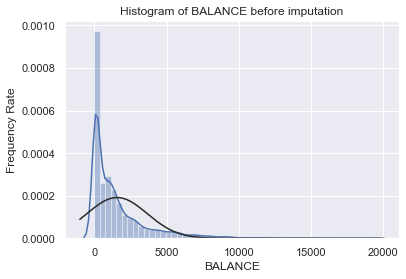

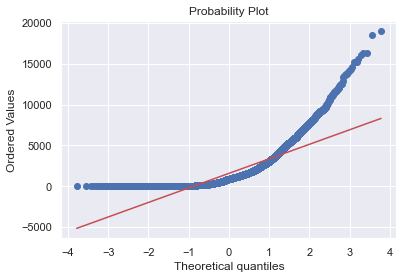

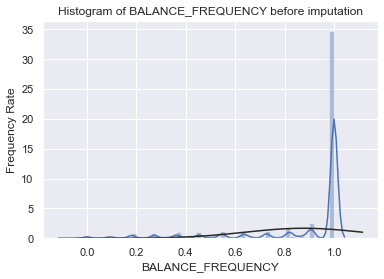

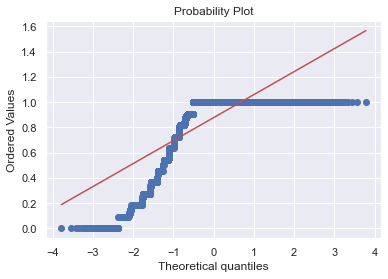

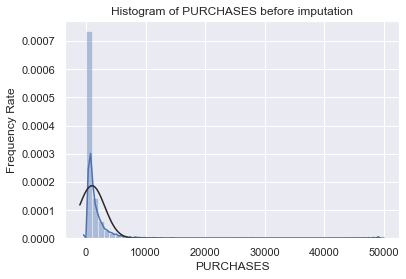

...

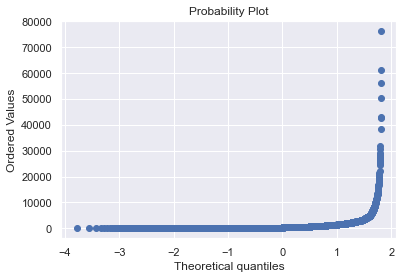

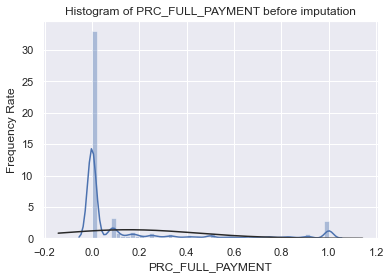

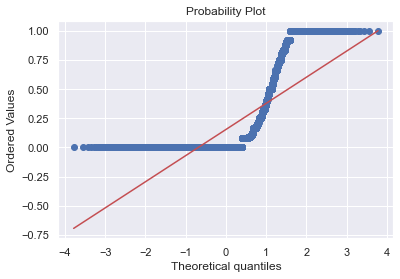

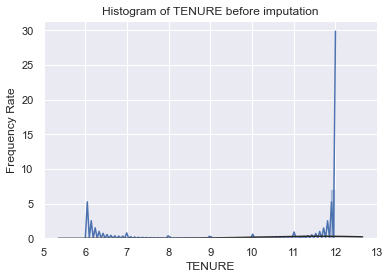

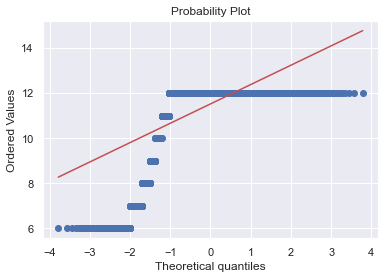

<Figure size 432x288 with 0 Axes>

In [18]:
visualise_floats(dataframe=credit_cards
          ,variables=floats
          ,target="usd_goal_real")

In [19]:
ks_projects_unique_counts = pd.DataFrame([[i, len(credit_cards[i].unique())] for i in credit_cards.columns], columns=['Variable', 'Number of Unique Values']).set_index('Variable')
ks_projects_unique_counts

,Number of Unique Values
Variable,
BALANCE,8871
BALANCE_FREQUENCY,43
PURCHASES,6203
ONEOFF_PURCHASES,4014
INSTALLMENTS_PURCHASES,4452
CASH_ADVANCE,4323
PURCHASES_FREQUENCY,47
ONEOFF_PURCHASES_FREQUENCY,47
PURCHASES_INSTALLMENTS_FREQUENCY,47


### List of categories

### Creating a copy of "TENURE" to get some visualisations

In [20]:
credit_cards["TENURE_as_object"] = credit_cards["TENURE"].astype(object)

In [21]:
categories = credit_cards.select_dtypes(include=["object"]).columns
categories

Index(['TENURE_as_object'], dtype='object')

### Distributions of categories

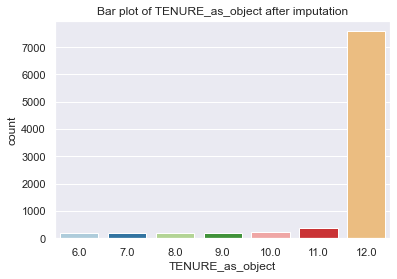

<Figure size 432x288 with 0 Axes>

In [22]:
for category in categories:
    ax = sns.countplot(credit_cards[category], palette="Paired")
    ax.set_title("Bar plot of " + str(category) + " after imputation")
    ax.set_xlabel(str(category))
    fig = plt.figure()

### Box plots

In [23]:
floatss = floats.tolist()

In [24]:
floatss.remove('TENURE')

In [25]:
floatss

['BALANCE',
 'BALANCE_FREQUENCY',
 'PURCHASES',
 'ONEOFF_PURCHASES',
 'INSTALLMENTS_PURCHASES',
 'CASH_ADVANCE',
 'PURCHASES_FREQUENCY',
 'ONEOFF_PURCHASES_FREQUENCY',
 'PURCHASES_INSTALLMENTS_FREQUENCY',
 'CASH_ADVANCE_FREQUENCY',
 'CASH_ADVANCE_TRX',
 'PURCHASES_TRX',
 'CREDIT_LIMIT',
 'PAYMENTS',
 'MINIMUM_PAYMENTS',
 'PRC_FULL_PAYMENT']

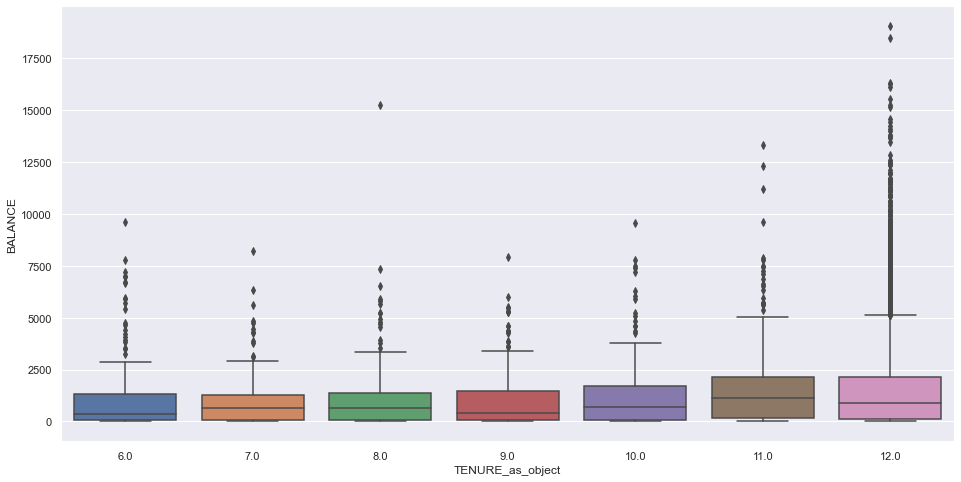

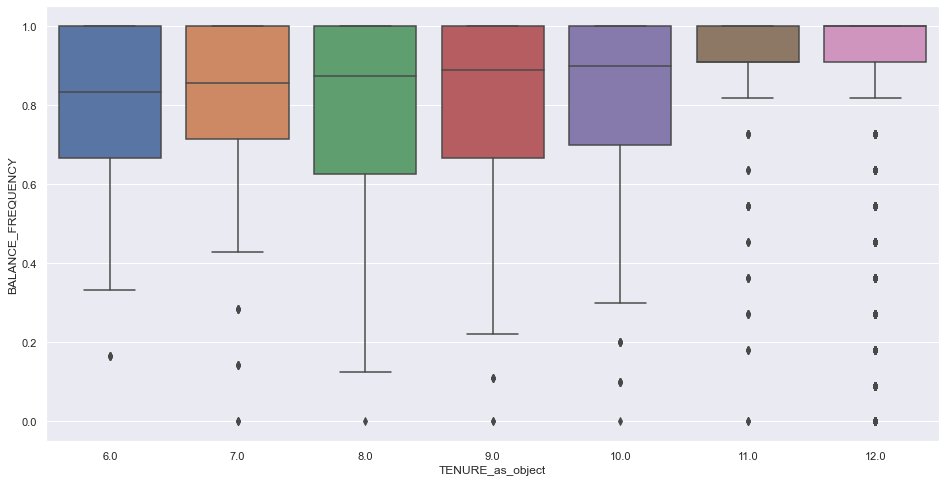

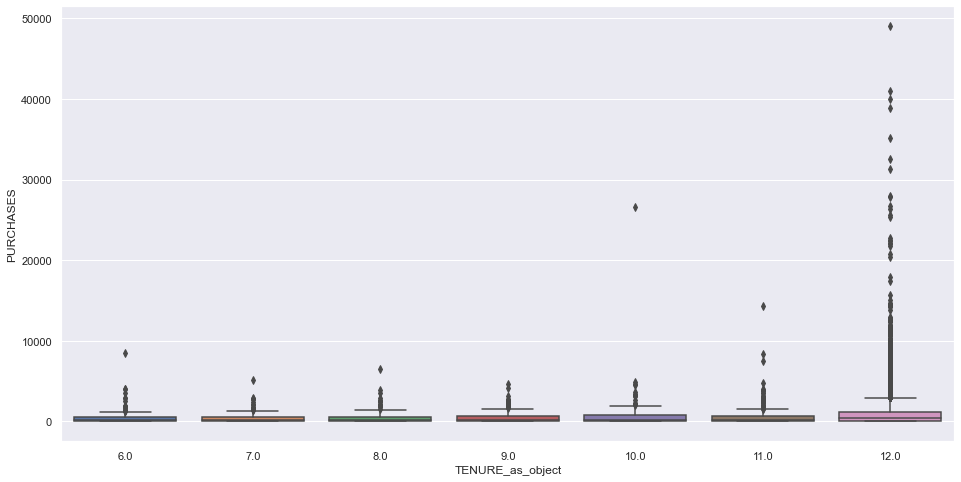

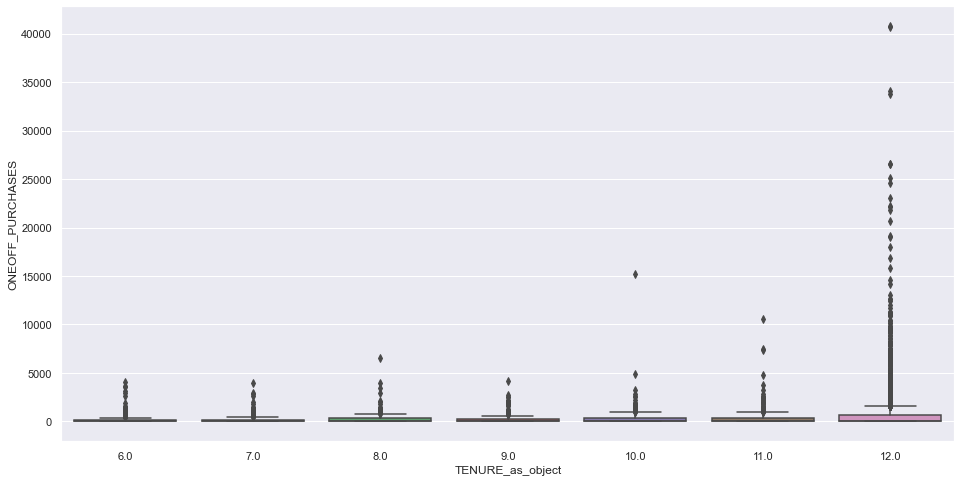

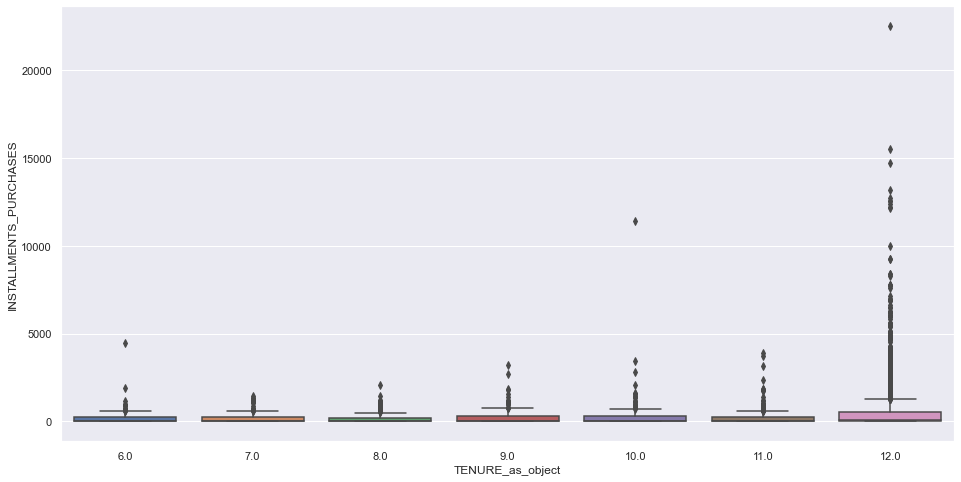

...

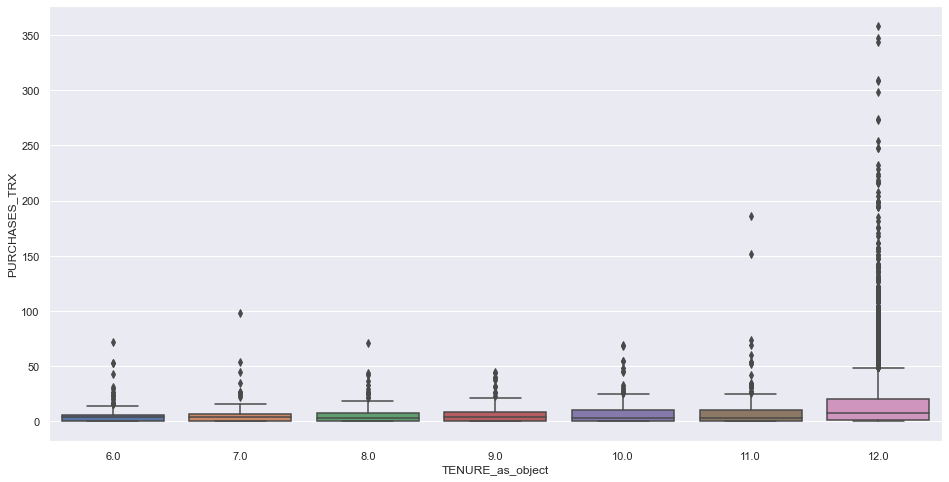

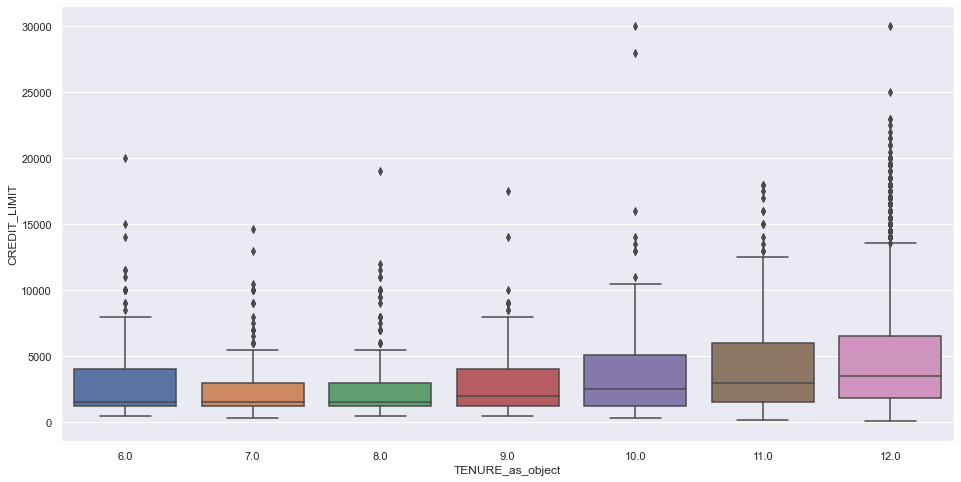

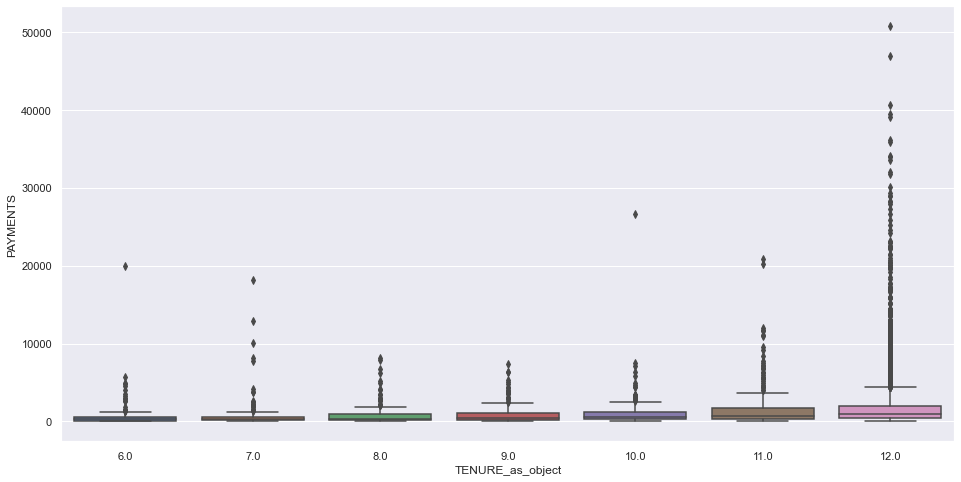

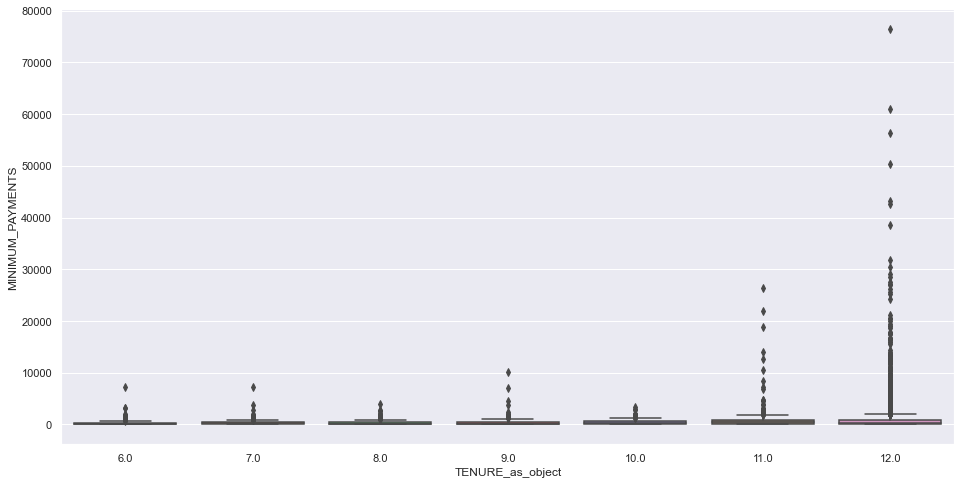

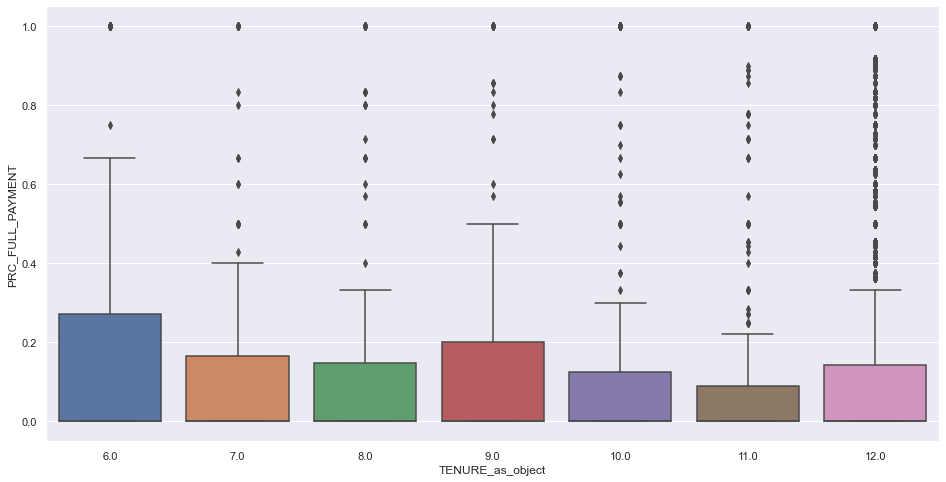

In [26]:
for category in categories:
    for floatt in floatss:
        f, ax = plt.subplots(figsize=(16, 8))
        fig = sns.boxplot(x=category, y=floatt, data=credit_cards)
        fig.axis()
        plt.show()

### Initial correlation matrix

In [27]:
plt.subplots(figsize=(28,28))
matrix = np.triu(credit_cards.corr())
sns_plot = sns.heatmap(credit_cards.corr(), annot=True, mask=matrix)
fig = sns_plot.get_figure()
fig.savefig("ini_corr_matrix.jpg")
plt.clf()

<Figure size 2016x2016 with 0 Axes>

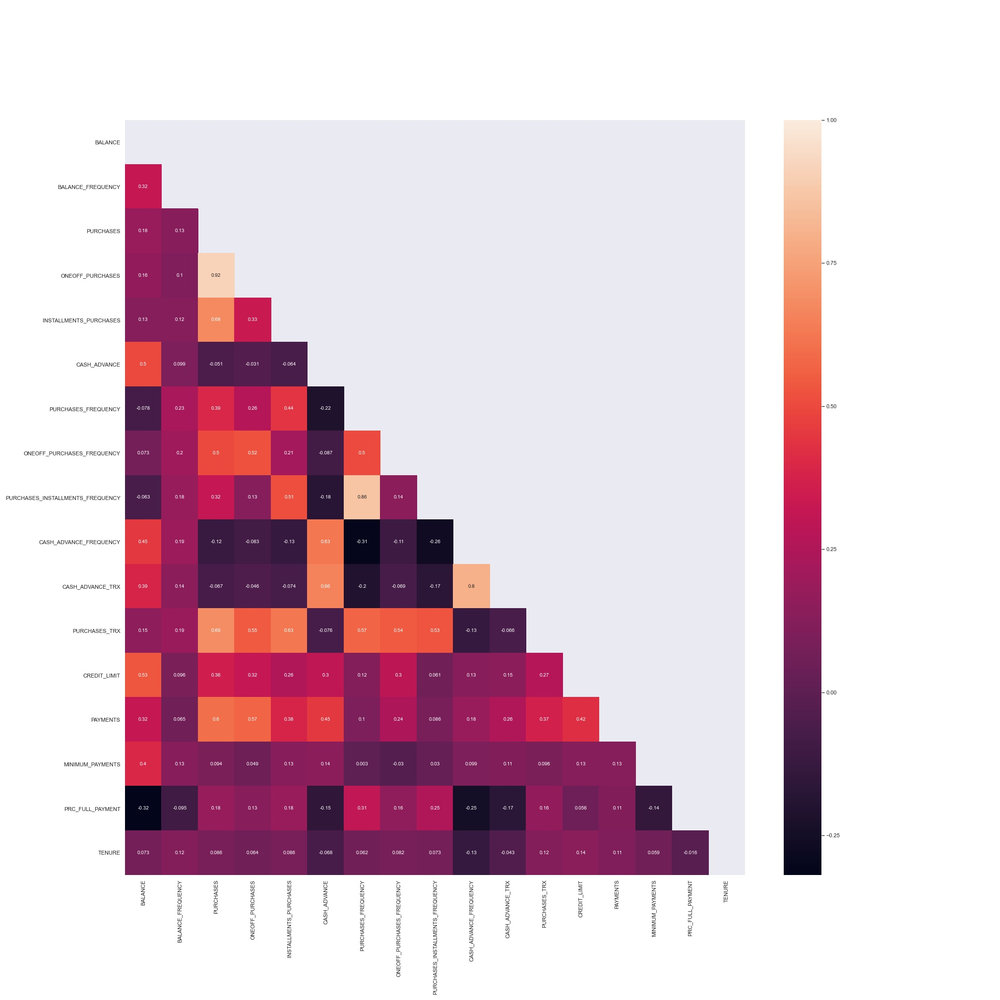

In [28]:
Image(filename='ini_corr_matrix.jpg')

### Initial pair plot

In [29]:
# sns.set()
# fig = sns.pairplot(credit_cards[floats], size = 5)
# plt.show();
# fig.savefig("ini_pair_plot.jpg")
# plt.clf()

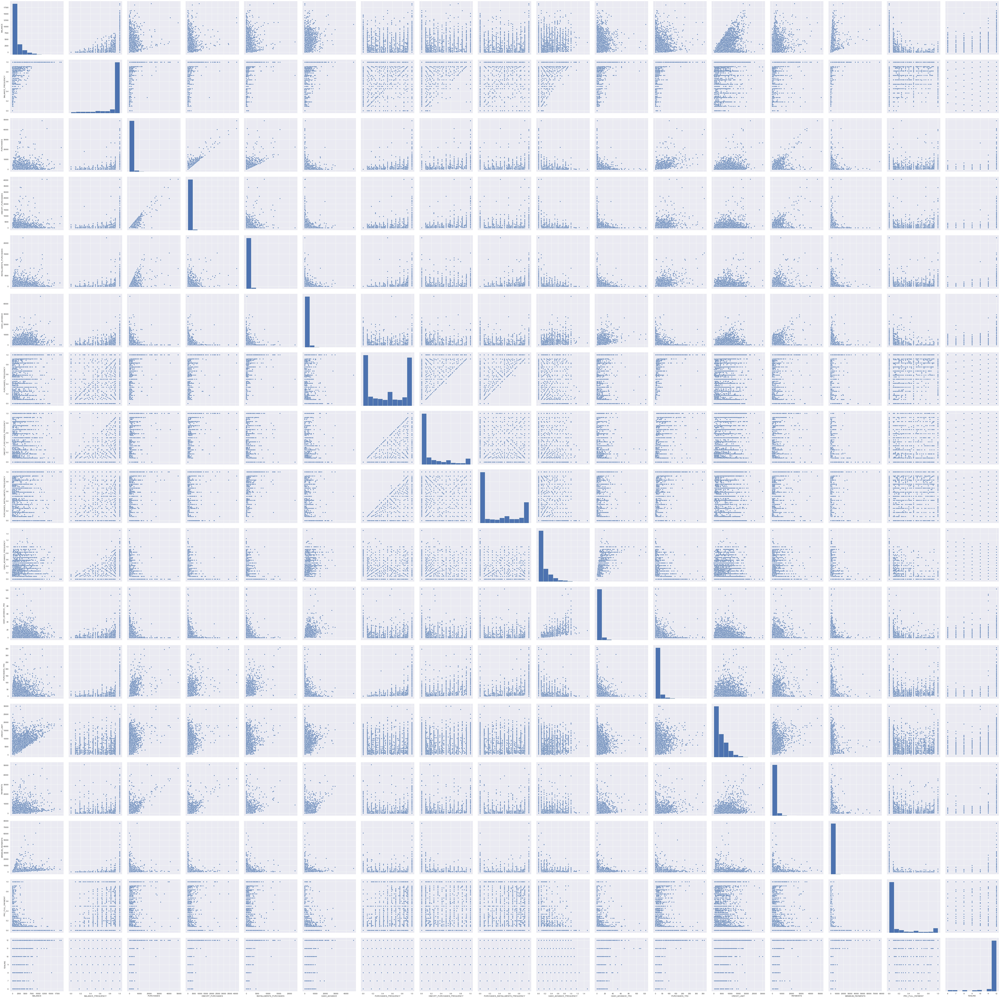

In [30]:
Image(filename='ini_pair_plot.jpg')

# 5. Dealing with NULL values

In [31]:
credit_cards = credit_cards[floats].fillna(value=credit_cards.median())

In [32]:
credit_cards.isna().sum()

BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

# 6. K-Means

### Inertia

In [33]:
inertia = []
for k in range(1,30):
    kmeans = KMeans(n_clusters=k, n_init=15)
    kmeans.fit_predict(credit_cards)
    inertia.append(kmeans.inertia_)

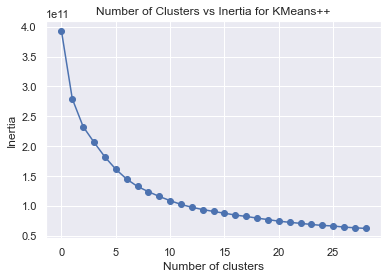

In [34]:
plt.plot(inertia, "o-", label="Inertia")
plt.title("Number of Clusters vs Inertia for KMeans++")
plt.xlabel("Number of clusters")
plt.ylabel("Inertia")
plt.show()

In [35]:
kmeans = KMeans(n_clusters=2, init="k-means++", n_init=2**3, max_iter=300)

In [36]:
y_predict = kmeans.fit_predict(credit_cards)

In [37]:
credit_cards["cluster"] = y_predict

### Pair plot for clusters

In [38]:
# sns.set()
# fig = sns.pairplot(credit_cards[credit_cards.columns], hue="cluster", size = 5)
# plt.show();
# fig.savefig("two_clusters_pair_plot.jpg")
# plt.clf()

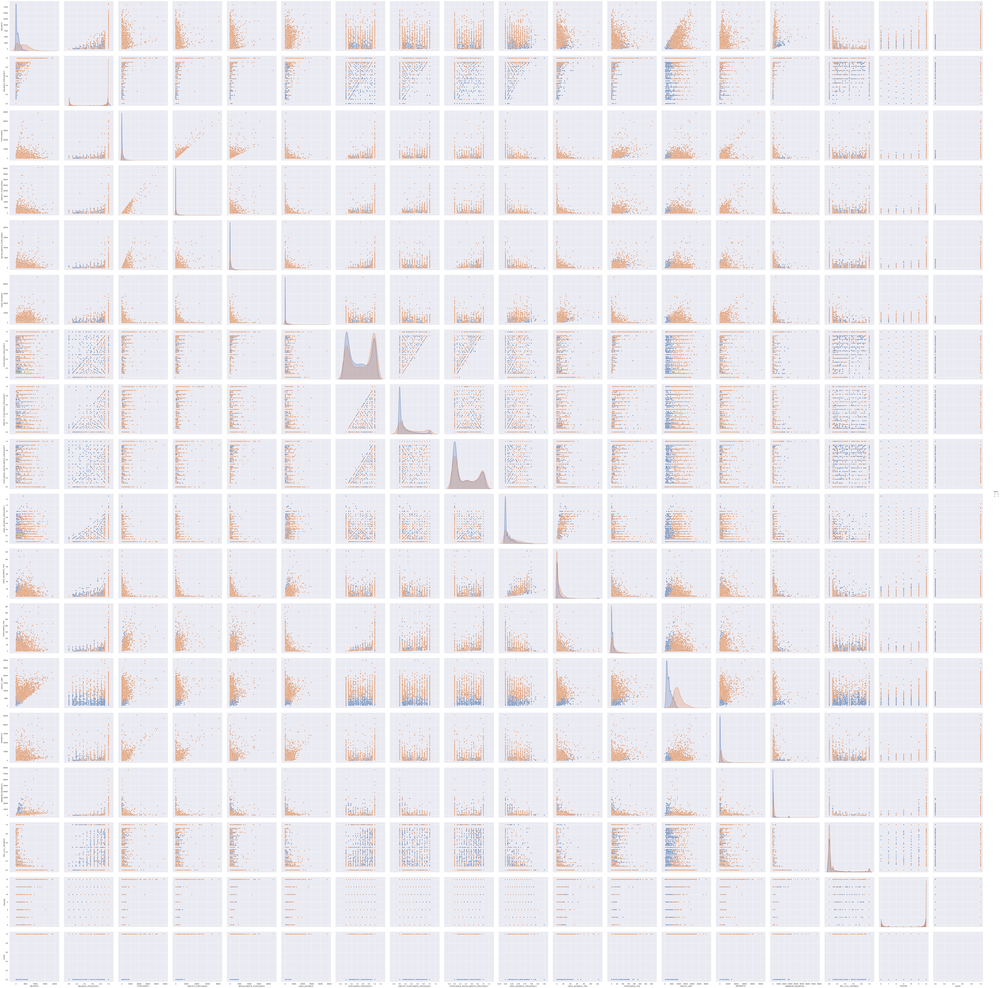

In [39]:
Image(filename='two_clusters_pair_plot.jpg')

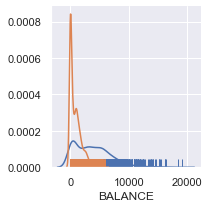

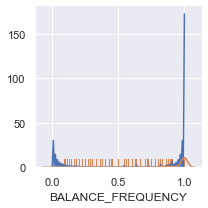

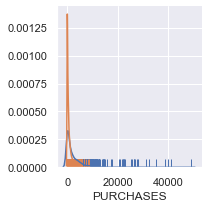

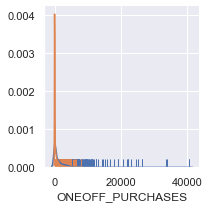

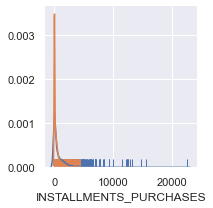

...

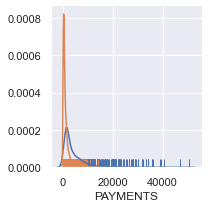

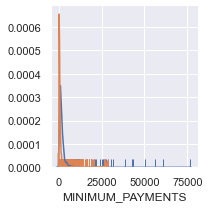

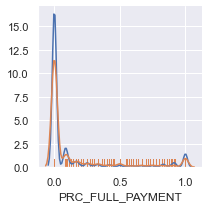

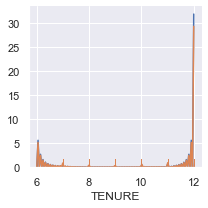

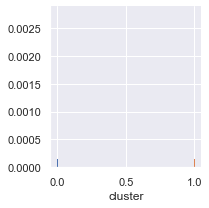

In [40]:
for column in credit_cards:
    fig = sns.FacetGrid(credit_cards, hue='cluster')
    fig.map(sns.distplot, column, hist=False, rug=True)

### Keeping variables which are discriminating well between two clusters and those which are not exhibiting strong correlation

* BALANCE
* PURCHASES  
~~* ONEOFF_PURCHASES~~  
~~* INSTALLMENTS_PURCHASES~~  
~~* CASH_ADVANCE~~  
* ONEOFF_PURCHASES_FREQUENCY
* CASH_ADVANCE_FREQUENCY
* CREDIT_LIMIT  
~~* PAYMENTS~~

In [41]:
variables_to_keep = ["BALANCE", "PURCHASES", "ONEOFF_PURCHASES_FREQUENCY", "CASH_ADVANCE_FREQUENCY", "CREDIT_LIMIT"]
credit_cards[variables_to_keep].head()

,BALANCE,PURCHASES,ONEOFF_PURCHASES_FREQUENCY,CASH_ADVANCE_FREQUENCY,CREDIT_LIMIT
CUST_ID,,,,,
C10001,40.901,95.400,0.000,0.000,1000.000
C10002,3202.467,0.000,0.000,0.250,7000.000
C10003,2495.149,773.170,1.000,0.000,7500.000
C10004,1666.671,1499.000,0.083,0.083,7500.000
C10005,817.714,16.000,0.083,0.000,1200.000


### Reduced correlation matrix

In [42]:
plt.subplots(figsize=(24,10))
matrix = np.triu(credit_cards[variables_to_keep].corr())
sns_plot = sns.heatmap(credit_cards[variables_to_keep].corr(), annot=True, mask=matrix)
fig = sns_plot.get_figure()
fig.savefig("corr_matrix_reduced.jpg")
plt.clf()

<Figure size 1728x720 with 0 Axes>

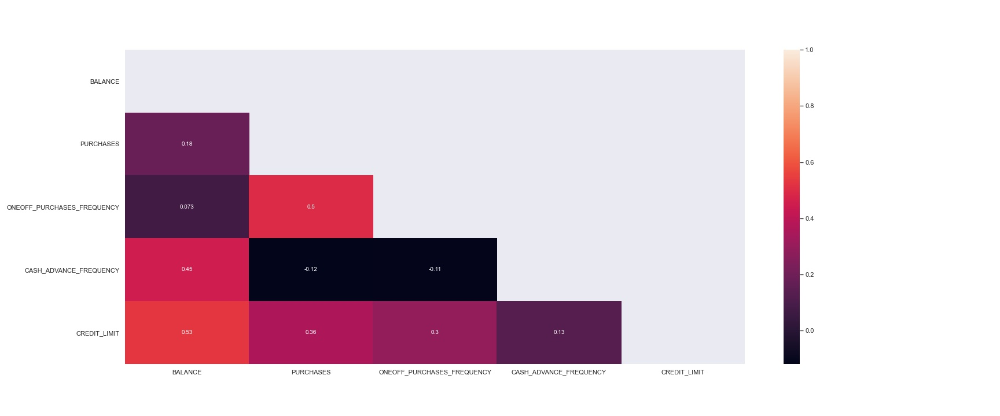

In [43]:
Image(filename='corr_matrix_reduced.jpg')

### Training KMeans again on reduced data set

In [44]:
kmeans = KMeans(n_clusters=2, init="k-means++", n_init=2**3, max_iter=300)

In [45]:
y_predict = kmeans.fit_predict(credit_cards[variables_to_keep])

In [46]:
credit_cards["cluster"] = y_predict

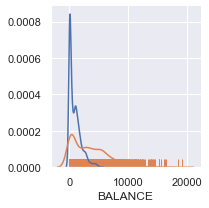

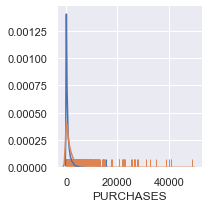

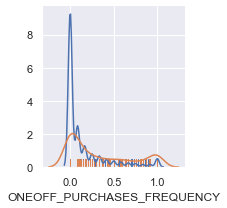

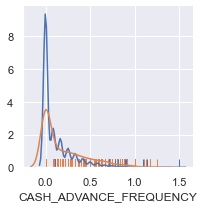

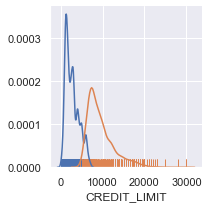

In [47]:
for column in credit_cards[variables_to_keep]:
    fig = sns.FacetGrid(credit_cards, hue='cluster')
    fig.map(sns.distplot, column, hist=False, rug=True)

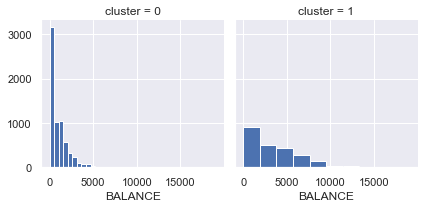

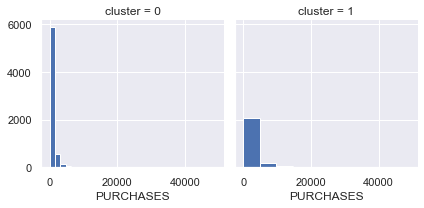

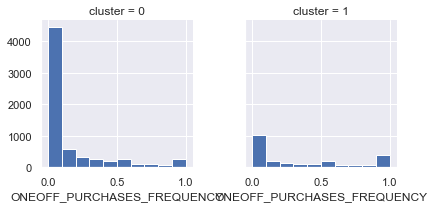

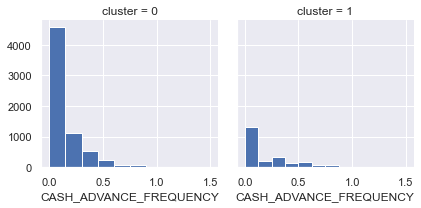

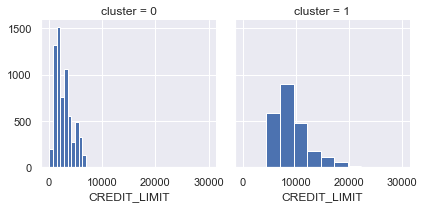

In [48]:
for column in credit_cards[variables_to_keep]:
    fig = sns.FacetGrid(credit_cards, col="cluster")
    fig.map(plt.hist, column)

### Training KMeans with three clusters on reduced data set

In [49]:
credit_cards = credit_cards[variables_to_keep]

In [50]:
credit_cards.head()

,BALANCE,PURCHASES,ONEOFF_PURCHASES_FREQUENCY,CASH_ADVANCE_FREQUENCY,CREDIT_LIMIT
CUST_ID,,,,,
C10001,40.901,95.400,0.000,0.000,1000.000
C10002,3202.467,0.000,0.000,0.250,7000.000
C10003,2495.149,773.170,1.000,0.000,7500.000
C10004,1666.671,1499.000,0.083,0.083,7500.000
C10005,817.714,16.000,0.083,0.000,1200.000


### KMeans

In [51]:
kmeans = KMeans(n_clusters=3, init="k-means++", n_init=3**3, max_iter=300)

In [52]:
y_predict = kmeans.fit_predict(credit_cards)

In [53]:
credit_cards["cluster"] = y_predict

In [54]:
# sns.set()
# fig = sns.pairplot(credit_cards[credit_cards.columns], hue="cluster", size = 5)
# plt.show();
# fig.savefig("three_clusters_pair_plot.jpg")
# plt.clf()

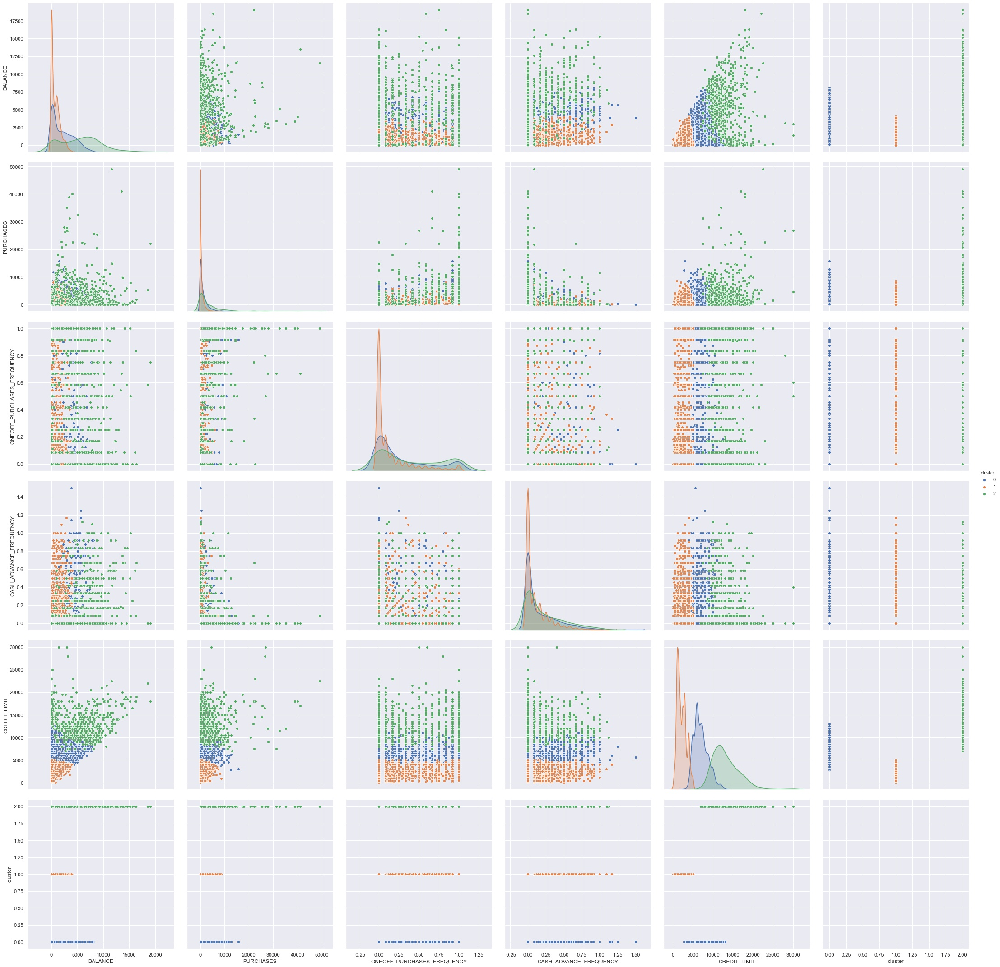

In [55]:
Image(filename='three_clusters_pair_plot.jpg')

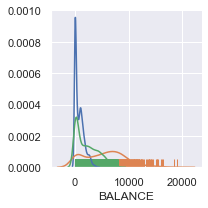

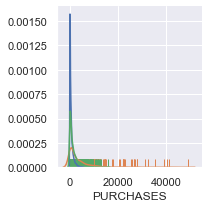

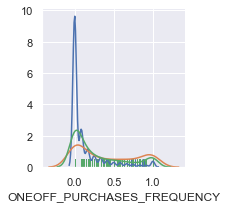

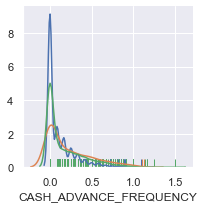

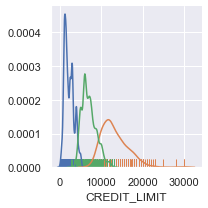

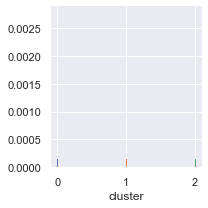

In [56]:
for column in credit_cards:
    fig = sns.FacetGrid(credit_cards, hue='cluster')
    fig.map(sns.distplot, column, hist=False, rug=True)

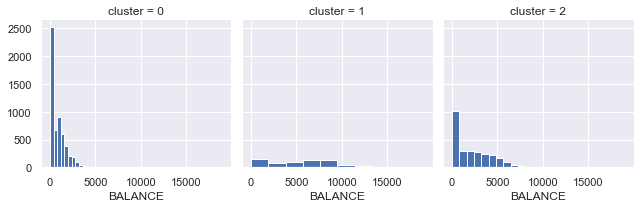

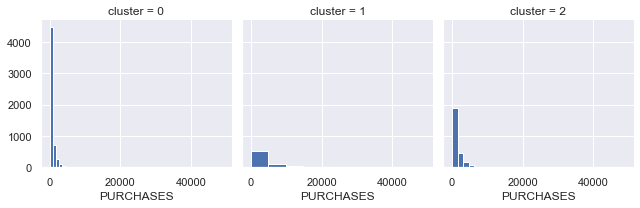

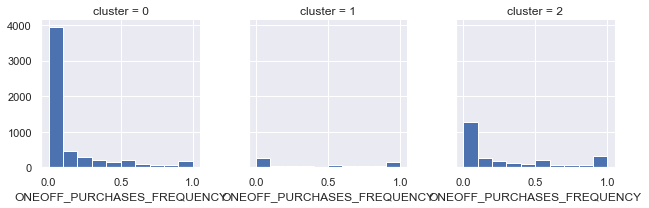

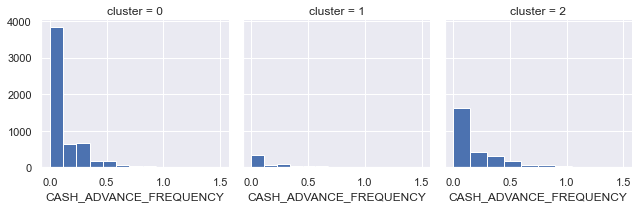

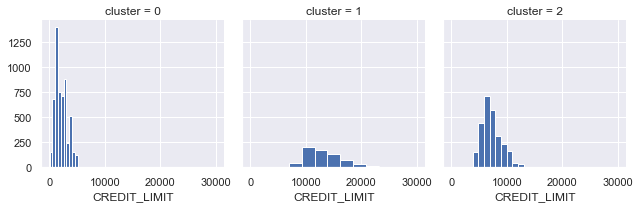

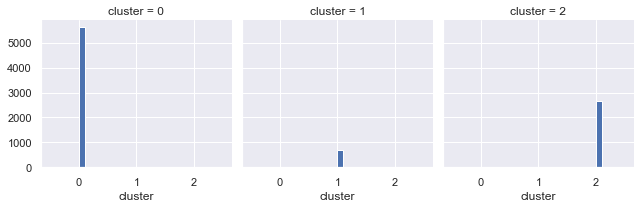

In [57]:
for column in credit_cards:
    fig = sns.FacetGrid(credit_cards, col="cluster")
    fig.map(plt.hist, column)